# 1. Стандартизация и очистка библиотеки

### Подгрузили

In [13]:
import pandas as pd

df = pd.read_csv("data/input_library.smi", sep=" ", header=None, names=["smiles", "id"])
df


,smiles,id
0,C=CCn1c(SCC(N)=O)nnc1-c1ccccn1.K,compound_2146
1,COc1ccc(C(=O)Nc2ccc(Cn3ccnc3)cc2)cc1OC,compound_0184
2,O=C(OCc1ccccc1)N1CCCCC1CCO,compound_1149
3,O=C(CCC(=O)c1cccs1)Nc1ccccc1F,compound_2747
4,CC(=O)n1c(=O)n(C(C)=O)c2cc(Br)ccc21,compound_1334
...,...,...
2993,CCn1c(CCCNC(=O)c2ccco2)nc2ccccc21,compound_0998
2994,Cc1c(Cl)cccc1N(CC(=O)N1CCCC1)S(C)(=O)=O,compound_0715
2995,NC(=O)c1ccccc1NC(=O)c1ccccc1-c1ccccc1,compound_0317
2996,CNC(=O)c1ccc(C(=O)N(C(C)C)C(C)C)cc1,compound_2675


### Посмотрели Глазками

In [14]:
import mols2grid
#mols2grid.display(df, smiles_col="smiles")

### Базовый препроцессинг

In [15]:
import datamol as dm

def _preprocess(i, row):
    dm.disable_rdkit_log()
    mol = dm.to_mol(row["smiles"], ordered=True, sanitize=False)
    if mol is None:
        smiles_main = row["smiles"].split(".")[0] # Фиксит кейсы типа C=CCn1c(SCC(N)=O)nnc1-c1ccccn1.K где K записан не верно
        #print(f"Trying split for: {row['smiles']} -> {smiles_main}") 
        mol = dm.to_mol(smiles_main, ordered=True, sanitize=False)
        if mol is None:
            print(f"Error: {row['smiles']}")
            row["standard_smiles"] = None
            return row

    mol = dm.remove_salts_solvents(mol)
    mol = dm.fix_mol(mol)
    mol = dm.sanitize_mol(mol, sanifix=True, charge_neutral=False)
            
    mol = dm.standardize_mol(
        mol, disconnect_metals=False, normalize=True, reionize=True, uncharge=False, stereo=True
    )
    
    row["standard_smiles"] = dm.to_smiles(mol, canonical = True)
    
    return row

data_clean = dm.parallelized(_preprocess, df.iterrows(), arg_type="args", progress=True, total=len(df))
data_clean = [row for row in data_clean if row is not None]
data_clean = pd.DataFrame(data_clean)
data_clean

  0%|          | 0/2998 [00:00<?, ?it/s]

Error: O2N(C6H3)NO2


,smiles,id,standard_smiles
0,C=CCn1c(SCC(N)=O)nnc1-c1ccccn1.K,compound_2146,C=CCn1c(SCC(N)=O)nnc1-c1ccccn1
1,COc1ccc(C(=O)Nc2ccc(Cn3ccnc3)cc2)cc1OC,compound_0184,COc1ccc(C(=O)Nc2ccc(Cn3ccnc3)cc2)cc1OC
2,O=C(OCc1ccccc1)N1CCCCC1CCO,compound_1149,O=C(OCc1ccccc1)N1CCCCC1CCO
3,O=C(CCC(=O)c1cccs1)Nc1ccccc1F,compound_2747,O=C(CCC(=O)c1cccs1)Nc1ccccc1F
4,CC(=O)n1c(=O)n(C(C)=O)c2cc(Br)ccc21,compound_1334,CC(=O)n1c(=O)n(C(C)=O)c2cc(Br)ccc21
...,...,...,...
2993,CCn1c(CCCNC(=O)c2ccco2)nc2ccccc21,compound_0998,CCn1c(CCCNC(=O)c2ccco2)nc2ccccc21
2994,Cc1c(Cl)cccc1N(CC(=O)N1CCCC1)S(C)(=O)=O,compound_0715,Cc1c(Cl)cccc1N(CC(=O)N1CCCC1)S(C)(=O)=O
2995,NC(=O)c1ccccc1NC(=O)c1ccccc1-c1ccccc1,compound_0317,NC(=O)c1ccccc1NC(=O)c1ccccc1-c1ccccc1
2996,CNC(=O)c1ccc(C(=O)N(C(C)C)C(C)C)cc1,compound_2675,CNC(=O)c1ccc(C(=O)N(C(C)C)C(C)C)cc1


## Анализ пропущенных молекул

**Пропущена одна молекула:** `O2N(C6H3)NO2`

Данная структура представляет собой динитробензол - взрывчатое вещество. Восстановление этой молекулы технически возможно, но нецелесообразно в контексте разработки лекарственных препаратов.

In [16]:

print("Missing molecules:", data_clean['standard_smiles'].isna().sum())
data_clean = data_clean[data_clean['standard_smiles'].notna()]

Missing molecules: 1


In [17]:
data_clean = data_clean.drop(columns=['smiles'])
data_clean

,id,standard_smiles
0,compound_2146,C=CCn1c(SCC(N)=O)nnc1-c1ccccn1
1,compound_0184,COc1ccc(C(=O)Nc2ccc(Cn3ccnc3)cc2)cc1OC
2,compound_1149,O=C(OCc1ccccc1)N1CCCCC1CCO
3,compound_2747,O=C(CCC(=O)c1cccs1)Nc1ccccc1F
4,compound_1334,CC(=O)n1c(=O)n(C(C)=O)c2cc(Br)ccc21
...,...,...
2993,compound_0998,CCn1c(CCCNC(=O)c2ccco2)nc2ccccc21
2994,compound_0715,Cc1c(Cl)cccc1N(CC(=O)N1CCCC1)S(C)(=O)=O
2995,compound_0317,NC(=O)c1ccccc1NC(=O)c1ccccc1-c1ccccc1
2996,compound_2675,CNC(=O)c1ccc(C(=O)N(C(C)C)C(C)C)cc1


### Убрали дубликаты

In [18]:
duplicates_mask = data_clean.duplicated(subset=['standard_smiles'], keep='first')
print(f"Found duplicates: {duplicates_mask.sum()}")
data_clean = data_clean[~duplicates_mask].reset_index(drop=True)
print(f"Molecules remaining after duplicate removal: {len(data_clean)}")


Found duplicates: 76
Molecules remaining after duplicate removal: 2921


### Определение ближайших аналогов по Tanimoto-сходству (ECFP4)
В будущем можно выбрать одну молекулу из кластера, если есть потребность уменьшить набор молекул

Или поставить другие пороговые значения. 

Пока что сознательно ничего не делал и не убирал похожие молекулы

In [19]:
import datamol as dm
import matplotlib.pyplot as plt

smiles = data_clean["standard_smiles"].tolist()
mols = [dm.to_mol(s) for s in smiles]

import numpy as np

clusters, mol_clusters = dm.cluster_mols(mols, cutoff=0.4)


In [20]:
cluster_sizes = [len(cluster) for cluster in clusters]
print(f"Number of clusters: {len(clusters)}")
print(f"Cluster sizes: {sorted(cluster_sizes, reverse=True)[:10]}")


Number of clusters: 2753
Cluster sizes: [5, 4, 4, 3, 3, 3, 3, 3, 3, 3]


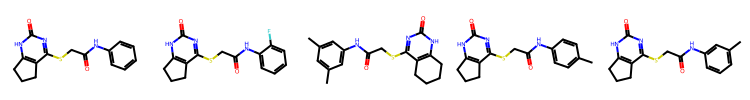

In [21]:
dm.to_image(mol_clusters[0], mol_size=(150, 100), n_cols=6, max_mols=18)

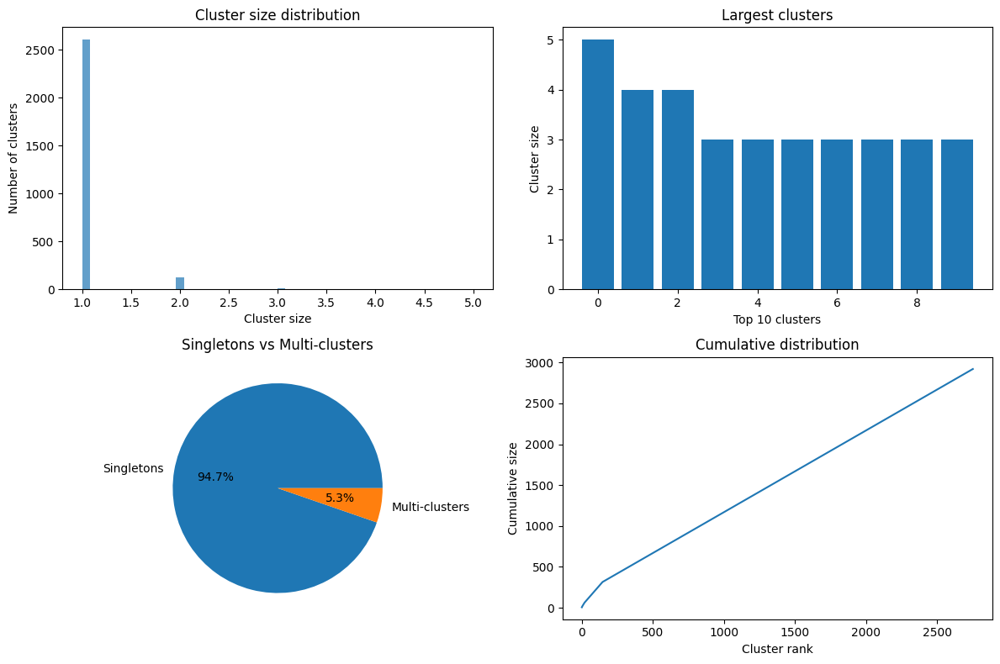

In [22]:

plt.figure(figsize=(12, 8))
plt.subplot(2, 2, 1)
plt.hist(cluster_sizes, bins=50, alpha=0.7)
plt.xlabel('Cluster size')
plt.ylabel('Number of clusters')
plt.title('Cluster size distribution')

plt.subplot(2, 2, 2)
cluster_df = pd.DataFrame({'cluster_id': range(len(clusters)), 'size': cluster_sizes})
top_clusters = cluster_df.nlargest(10, 'size')
plt.bar(range(len(top_clusters)), top_clusters['size'])
plt.xlabel('Top 10 clusters')
plt.ylabel('Cluster size')
plt.title('Largest clusters')

plt.subplot(2, 2, 3)
singleton_count = sum(1 for size in cluster_sizes if size == 1)
multi_count = len(clusters) - singleton_count
plt.pie([singleton_count, multi_count], labels=['Singletons', 'Multi-clusters'], autopct='%1.1f%%')
plt.title('Singletons vs Multi-clusters')

plt.subplot(2, 2, 4)
cumsum_sizes = np.cumsum(sorted(cluster_sizes, reverse=True))
plt.plot(range(1, len(cumsum_sizes) + 1), cumsum_sizes)
plt.xlabel('Cluster rank')
plt.ylabel('Cumulative size')
plt.title('Cumulative distribution')

plt.tight_layout()
plt.show()


## Фильтруем

Filter based on a compound phychem properties

In [23]:
import medchem as mc

data_clean["mol"] = data_clean["standard_smiles"].apply(dm.to_mol)
data_clean

data_clean["rule_of_five"] = data_clean["standard_smiles"].apply(mc.rules.basic_rules.rule_of_five)
data_clean["rule_of_ghose"] = data_clean["standard_smiles"].apply(mc.rules.basic_rules.rule_of_ghose)
data_clean["rule_of_veber"] = data_clean["standard_smiles"].apply(mc.rules.basic_rules.rule_of_veber)
data_clean["rule_of_reos"] = data_clean["standard_smiles"].apply(mc.rules.basic_rules.rule_of_reos)



Filter based on a list of structural alerts

Добавил ещё фильтров, по своему усмотрению

In [24]:
import warnings
warnings.filterwarnings("ignore", category=RuntimeWarning, module="importlib._bootstrap")

with dm.without_rdkit_log():
    mols = data_clean["mol"].tolist()
    
    for alert_type in ["BMS", "PAINS", "SureChEMBL", "Chelator", "AlphaScreen-Hitters", "Frequent-Hitter"]:
        data_clean[f"alerts_{alert_type}"] = mc.functional.alert_filter(mols, alerts=[alert_type], n_jobs=-1, progress=True, return_idx=False)
    
    data_clean["filters_NIBR"] = mc.functional.nibr_filter(mols, n_jobs=-1, progress=True, return_idx=False)
    data_clean["filter_complexity"] = mc.functional.complexity_filter(mols, complexity_metric="bertz", threshold_stats_file="zinc_15_available", n_jobs=-1, progress=True, return_idx=False)
    data_clean["filter_bredt"] = mc.functional.bredt_filter(mols, n_jobs=-1, progress=True, return_idx=False)
    data_clean["filter_molecular_graph"] = mc.functional.molecular_graph_filter(mols, max_severity=5, n_jobs=-1, progress=True, return_idx=False)

Common alerts filtering:   0%|          | 0/2921 [00:00<?, ?it/s]

<frozen importlib._bootstrap>:241: RuntimeWarning: to-Python converter for boost::shared_ptr<RDKit::FilterHierarchyMatcher> already registered; second conversion method ignored.
<frozen importlib._bootstrap>:241: RuntimeWarning: to-Python converter for boost::shared_ptr<RDKit::FilterHierarchyMatcher> already registered; second conversion method ignored.
<frozen importlib._bootstrap>:241: RuntimeWarning: to-Python converter for boost::shared_ptr<RDKit::FilterHierarchyMatcher> already registered; second conversion method ignored.
<frozen importlib._bootstrap>:241: RuntimeWarning: to-Python converter for boost::shared_ptr<RDKit::FilterHierarchyMatcher> already registered; second conversion method ignored.
<frozen importlib._bootstrap>:241: RuntimeWarning: to-Python converter for boost::shared_ptr<RDKit::FilterHierarchyMatcher> already registered; second conversion method ignored.
<frozen importlib._bootstrap>:241: RuntimeWarning: to-Python converter for boost::shared_ptr<RDKit::FilterHier

Common alerts filtering:   0%|          | 0/2921 [00:00<?, ?it/s]

Common alerts filtering:   0%|          | 0/2921 [00:00<?, ?it/s]

Common alerts filtering:   0%|          | 0/2921 [00:00<?, ?it/s]

Common alerts filtering:   0%|          | 0/2921 [00:00<?, ?it/s]

Common alerts filtering:   0%|          | 0/2921 [00:00<?, ?it/s]

NIBR filtering:   0%|          | 0/2921 [00:00<?, ?it/s]

Complexity Evaluation:   0%|          | 0/2921 [00:00<?, ?it/s]

To mol:   0%|          | 0/2921 [00:00<?, ?it/s]

Filtering with catalogs:   0%|          | 0/29 [00:00<?, ?it/s]

Match:   0%|          | 0/2921 [00:00<?, ?it/s]

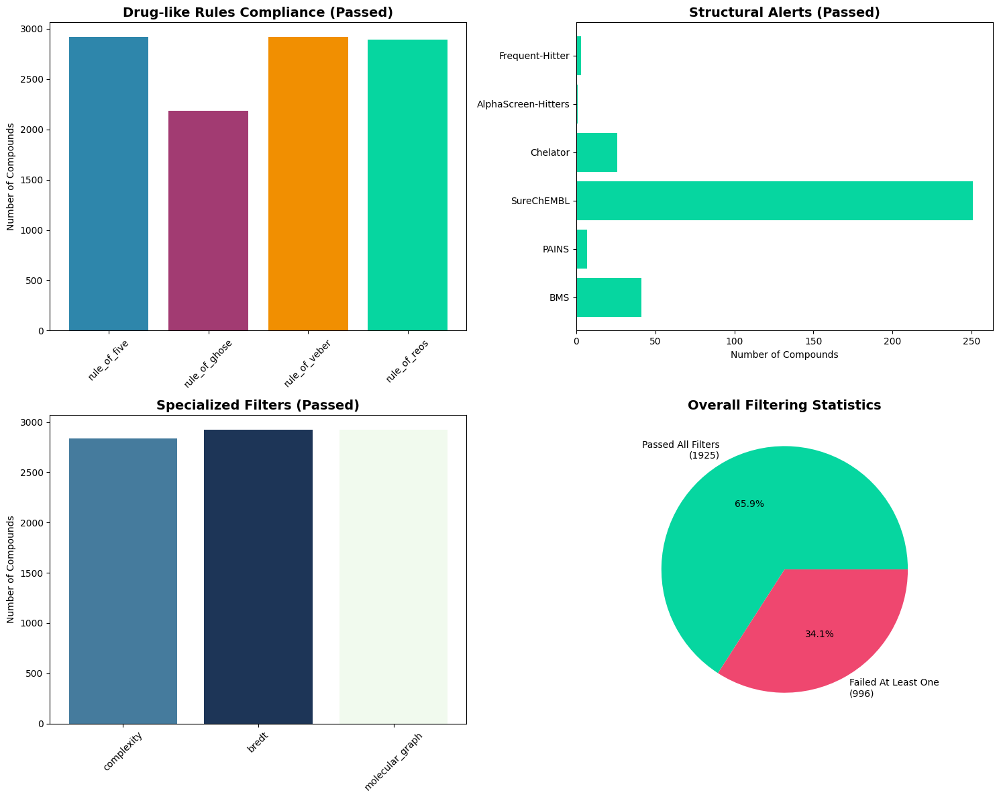

In [25]:
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

fig, axes = plt.subplots(2, 2, figsize=(15, 12))

rule_columns = ['rule_of_five', 'rule_of_ghose', 'rule_of_veber', 'rule_of_reos']
rule_stats = data_clean[rule_columns].sum()
axes[0, 0].bar(rule_stats.index, rule_stats.values, color=['#2E86AB', '#A23B72', '#F18F01', '#06D6A0'])
axes[0, 0].set_title('Drug-like Rules Compliance (Passed)', fontsize=14, fontweight='bold')
axes[0, 0].set_ylabel('Number of Compounds')
axes[0, 0].tick_params(axis='x', rotation=45)

alert_columns = [col for col in data_clean.columns if col.startswith('alerts_')]
alert_stats = (~data_clean[alert_columns]).sum()
alert_stats.index = [col.replace('alerts_', '') for col in alert_stats.index]
axes[0, 1].barh(alert_stats.index, alert_stats.values, color='#06D6A0')
axes[0, 1].set_title('Structural Alerts (Passed)', fontsize=14, fontweight='bold')
axes[0, 1].set_xlabel('Number of Compounds')

filter_columns = [col for col in data_clean.columns if col.startswith('filter_')]
filter_stats = data_clean[filter_columns].sum()
filter_stats.index = [col.replace('filter_', '') for col in filter_stats.index]
axes[1, 0].bar(filter_stats.index, filter_stats.values, color=['#457B9D', '#1D3557', '#F1FAEE'])
axes[1, 0].set_title('Specialized Filters (Passed)', fontsize=14, fontweight='bold')
axes[1, 0].set_ylabel('Number of Compounds')
axes[1, 0].tick_params(axis='x', rotation=45)

all_filters = rule_columns + alert_columns + filter_columns
passed_all = data_clean[all_filters].all(axis=1).sum()
failed_any = len(data_clean) - passed_all

pie_data = [passed_all, failed_any]
pie_labels = [f'Passed All Filters\n({passed_all})', f'Failed At Least One\n({failed_any})']
axes[1, 1].pie(pie_data, labels=pie_labels, autopct='%1.1f%%', colors=['#06D6A0', '#EF476F'])
axes[1, 1].set_title('Overall Filtering Statistics', fontsize=14, fontweight='bold')

plt.tight_layout()
plt.show()


In [26]:

print("="*60)
print("DETAILED FILTERING STATISTICS")
print("="*60)

print(f"\nTotal compounds: {len(data_clean)}")
print(f"Passed all filters: {passed_all} ({passed_all/len(data_clean)*100:.1f}%)")
print(f"Failed at least one filter: {failed_any} ({failed_any/len(data_clean)*100:.1f}%)")

print("\n" + "="*40)
print("DRUG-LIKE RULES (PASSED)")
print("="*40)
for rule in rule_columns:
    count = data_clean[rule].sum()
    print(f"{rule.replace('rule_of_', '').capitalize()}: {count} ({count/len(data_clean)*100:.1f}%)")

print("\n" + "="*40)
print("STRUCTURAL ALERTS (PASSED)")
print("="*40)
for col in alert_columns:
    alert_name = col.replace('alerts_', '')
    count = (~data_clean[col]).sum()
    print(f"{alert_name}: {count} passed ({count/len(data_clean)*100:.1f}%)")

print("\n" + "="*40)
print("SPECIALIZED FILTERS (PASSED)")
print("="*40)
for col in filter_columns:
    filter_name = col.replace('filter_', '')
    count = data_clean[col].sum()
    print(f"{filter_name}: {count} passed ({count/len(data_clean)*100:.1f}%)")

clean_subset = data_clean[data_clean[all_filters].all(axis=1)]
print(f"\n" + "="*60)
print(f"FINAL CLEAN LIBRARY: {len(clean_subset)} compounds")
print("="*60)


DETAILED FILTERING STATISTICS

Total compounds: 2921
Passed all filters: 1925 (65.9%)
Failed at least one filter: 996 (34.1%)

DRUG-LIKE RULES (PASSED)
Five: 2916 (99.8%)
Ghose: 2181 (74.7%)
Veber: 2916 (99.8%)
Reos: 2889 (98.9%)

STRUCTURAL ALERTS (PASSED)
BMS: 41 passed (1.4%)
PAINS: 7 passed (0.2%)
SureChEMBL: 251 passed (8.6%)
Chelator: 26 passed (0.9%)
AlphaScreen-Hitters: 1 passed (0.0%)
Frequent-Hitter: 3 passed (0.1%)

SPECIALIZED FILTERS (PASSED)
complexity: 2838 passed (97.2%)
bredt: 2921 passed (100.0%)
molecular_graph: 2921 passed (100.0%)

FINAL CLEAN LIBRARY: 1925 compounds


# 2. Вычисление дескрипторов и кластеризация

Дескрипторы

In [40]:
clean_subset["smiles"] = clean_subset["standard_smiles"]
clean_subset["standard_smiles"]
clean_subset.to_csv("data/clean_subset.csv")

In [28]:

mols = clean_subset.mol.tolist()

df = dm.descriptors.batch_compute_many_descriptors(mols)
df


,mw,fsp3,n_lipinski_hba,n_lipinski_hbd,n_rings,n_hetero_atoms,n_heavy_atoms,n_rotatable_bonds,n_radical_electrons,tpsa,...,sas,n_aliphatic_carbocycles,n_aliphatic_heterocyles,n_aliphatic_rings,n_aromatic_carbocycles,n_aromatic_heterocyles,n_aromatic_rings,n_saturated_carbocycles,n_saturated_heterocyles,n_saturated_rings
0,337.142641,0.157895,6,1,3,6,25,6,0,65.38,...,1.849994,0,0,0,2,1,3,0,0,0
1,311.062757,0.142857,5,1,2,7,21,5,0,64.63,...,1.627977,0,0,0,2,0,2,0,0,0
2,306.071508,0.384615,5,1,1,8,21,5,0,72.83,...,2.763119,0,0,0,1,0,1,0,0,0
3,349.142641,0.150000,6,2,3,6,26,4,0,83.96,...,2.023873,0,0,0,2,1,3,0,0,0
4,338.050732,0.230769,7,2,2,9,22,5,0,93.21,...,2.507475,0,0,0,1,1,2,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1920,345.116794,0.500000,6,0,2,9,23,6,0,55.95,...,2.749971,0,0,0,0,2,2,0,0,0
1921,297.147727,0.294118,5,1,3,5,22,6,0,60.06,...,2.028470,0,0,0,1,2,3,0,0,0
1922,330.080491,0.500000,5,0,2,7,21,4,0,57.69,...,2.144157,0,1,1,1,0,1,0,1,1
1923,316.121178,0.000000,4,3,3,4,24,4,0,72.19,...,1.586118,0,0,0,3,0,3,0,0,0


Распределние дескрипторов















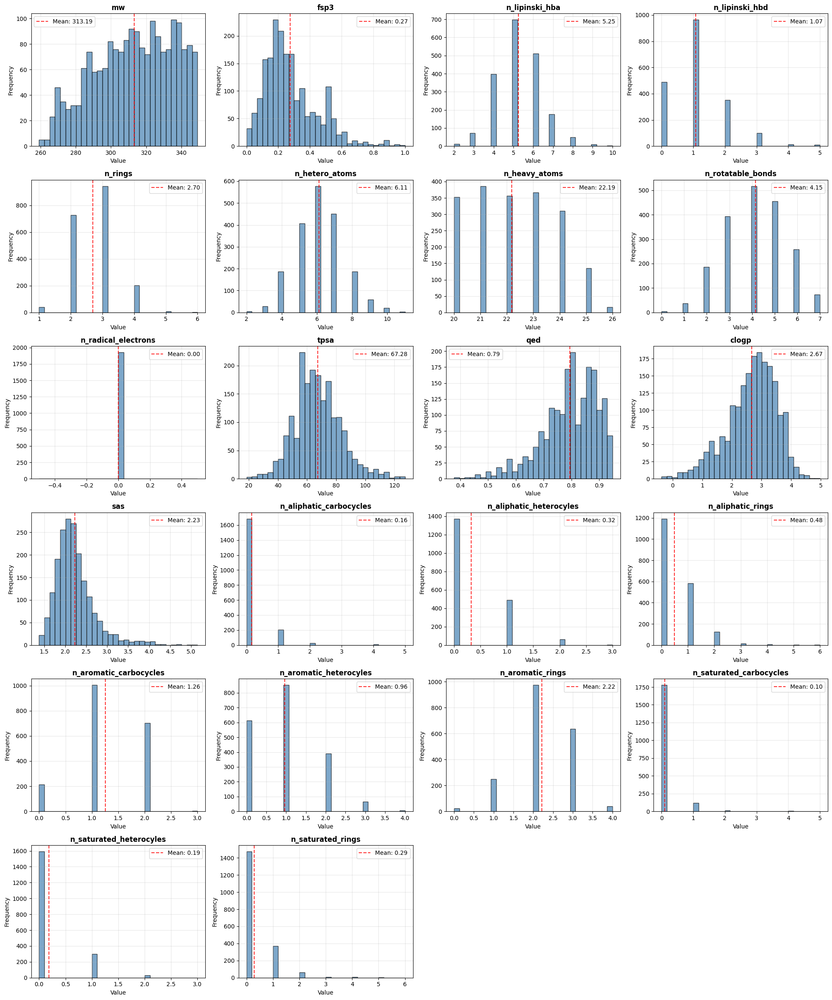

In [29]:

fig, axes = plt.subplots(6, 4, figsize=(20, 24))
axes = axes.flatten()

for i, col in enumerate(df.columns):
    if i >= len(axes):
        break
    
    ax = axes[i]
    
    if df[col].dtype in ['float64', 'int64']:
        ax.hist(df[col].dropna(), bins=30, alpha=0.7, color='steelblue', edgecolor='black')
        ax.set_title(f'{col}', fontsize=12, fontweight='bold')
        ax.set_xlabel('Value')
        ax.set_ylabel('Frequency')
        ax.grid(True, alpha=0.3)
        
        mean_val = df[col].mean()
        ax.axvline(mean_val, color='red', linestyle='--', alpha=0.8, label=f'Mean: {mean_val:.2f}')
        ax.legend()
for j in range(i+1, len(axes)):
    axes[j].set_visible(False)

plt.tight_layout()
plt.show()


Очень даже хорошее распределение дескрипторов, ничего обрезать дополнительно не стоит

### Кластеризация 

In [32]:
import pandas as pd
import datamol as dm

clean_subset = pd.read_csv("data/clean_subset.csv")

smiles = clean_subset["standard_smiles"].tolist()
mols = [dm.to_mol(s) for s in smiles]
fps = [dm.to_fp(mol) for mol in mols if mol is not None]








In [33]:
fps = [dm.to_fp(mol) for mol in mols]

In [34]:
from sklearn.metrics import silhouette_score
from sklearn.cluster import KMeans
import numpy as np

cutoffs = np.arange(0.2, 0.9, 0.1)
silhouette_scores = []
cluster_counts = []

for cutoff in cutoffs:
    clusters, mol_clusters = dm.cluster_mols(mols, cutoff=float(cutoff))
    n_clusters = len(clusters)
    
    if n_clusters > 1 and n_clusters < len(mols):
        cluster_labels = np.zeros(len(mols))
        for cluster_id, cluster_mols in enumerate(mol_clusters):
            for mol in cluster_mols:
                mol_idx = mols.index(mol)
                cluster_labels[mol_idx] = cluster_id
        
        score = silhouette_score(fps, cluster_labels)
        silhouette_scores.append(score)
        cluster_counts.append(n_clusters)
        print(f"Cutoff: {cutoff:.1f}, Clusters: {n_clusters}, Silhouette: {score:.3f}")

optimal_idx = np.argmax(silhouette_scores)
optimal_cutoff = cutoffs[optimal_idx]
print(f"\nOptimal cutoff: {optimal_cutoff:.1f}")

clusters, mol_clusters = dm.cluster_mols(mols, cutoff=float(optimal_cutoff))



Cutoff: 0.2, Clusters: 1923, Silhouette: 0.001
Cutoff: 0.3, Clusters: 1898, Silhouette: 0.008
Cutoff: 0.4, Clusters: 1821, Silhouette: 0.025
Cutoff: 0.5, Clusters: 1622, Silhouette: 0.044
Cutoff: 0.6, Clusters: 1234, Silhouette: 0.041
Cutoff: 0.7, Clusters: 767, Silhouette: -0.015
Cutoff: 0.8, Clusters: 260, Silhouette: -0.084

Optimal cutoff: 0.5


Silhouette ≈ 0.04 Это плохое разделение на кластеры
Стоит попробовать использовать другие методы кластеризации/фингеринги

In [35]:
from hdbscan import HDBSCAN
import numpy as np
from sklearn.metrics import silhouette_score

print("\nTesting HDBSCAN clustering:")
fps_array = np.array([list(fp) for fp in fps])

hdbscan_clusterer = HDBSCAN(min_cluster_size=5, min_samples=3, metric='jaccard')
hdbscan_labels = hdbscan_clusterer.fit_predict(fps_array)

n_hdbscan_clusters = len(set(hdbscan_labels)) - (1 if -1 in hdbscan_labels else 0)
n_noise = list(hdbscan_labels).count(-1)

if n_hdbscan_clusters > 1:
    valid_mask = hdbscan_labels != -1
    if np.sum(valid_mask) > 1:
        hdbscan_silhouette = silhouette_score(fps_array[valid_mask], hdbscan_labels[valid_mask])
        print(f"HDBSCAN - Clusters: {n_hdbscan_clusters}, Noise: {n_noise}, Silhouette: {hdbscan_silhouette:.3f}")
    else:
        print(f"HDBSCAN - Clusters: {n_hdbscan_clusters}, Noise: {n_noise}, Not enough points for Silhouette")
else:
    print(f"HDBSCAN - Clusters: {n_hdbscan_clusters}, Noise: {n_noise}")


Testing HDBSCAN clustering:


/home/nikolenko/work/Projects/geropharm/.venv/lib/python3.11/site-packages/sklearn/utils/deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/home/nikolenko/work/Projects/geropharm/.venv/lib/python3.11/site-packages/sklearn/utils/deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


HDBSCAN - Clusters: 2, Noise: 648, Silhouette: 0.062


Стало лучше, но не сильно, Данные очень однородны, стоит использовать другие фичи или уменьшить размерность

In [36]:
cluster_labels = np.zeros(len(mols))
for cluster_id, cluster_mols in enumerate(mol_clusters):
    for mol in cluster_mols:
        mol_idx = mols.index(mol)
        cluster_labels[mol_idx] = cluster_id

clean_subset.loc[:, 'cluster'] = cluster_labels.astype(int)


Смотрим кластеры вручную

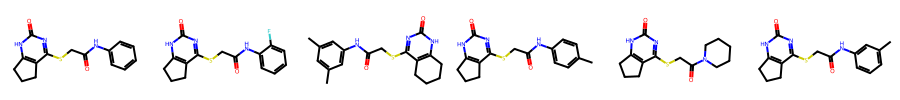

In [37]:
dm.to_image(mol_clusters[0], mol_size=(150, 100), n_cols=6, max_mols=18)

Смотрим Комплексно

In [38]:

import mols2grid
#mols2grid.display(clean_subset, mol_col="mol", subset=['cluster'])

Визауализируем кластеры с UMAP

(тут иначе на кластеры разбито)

In [41]:
from utils.ChemSpace import ChemSpaceViz

viz = ChemSpaceViz(
    file_paths='data/clean_subset.csv',
    reduction_method="umap",
    perplexity=60,
    color_by="cluster",
    n_clusters=None,
    point_size=5
)
viz.plot()

Loading data from files:
  data/clean_subset.csv
Total molecules loaded: 1925
Converting SMILES to molecules and filtering invalid ones...
Calculating fingerprints for unique molecules in parallel...


  0%|          | 0/1925 [00:00<?, ?it/s]

Reducing dimensions using UMAP
Determining optimal number of clusters using the Elbow Method...
Searching optimal k...
    k      inertia  silhouette  calinski_harabasz  davies_bouldin
0   2  3838.117920    0.360950        1274.157349        1.106426
1   3  2415.417236    0.383465        1577.541626        0.869997
2   4  1835.143433    0.364465        1585.964233        0.878742
3   5  1540.428955    0.348992        1508.122925        0.946719
4   6  1266.329468    0.358231        1549.942993        0.833153
5   7  1042.587891    0.362569        1636.613281        0.819742
6   8   901.778076    0.363626        1663.761841        0.796743
7   9   815.601196    0.347510        1634.100586        0.837165
8  10   711.105286    0.359511        1696.339600        0.842459
Elbow=3, Silhouette=3, CH=10, DB=8 -> chosen k=3
Optimal k = 3
Clustering data with KMeans...
Clusters found: [np.int32(0), np.int32(1), np.int32(2)]


Loading BokehJS ...

На UMAP можно заметить группы похожих молекул, но в остальном кластеров нет, есть смысл использовать другие Отпечатки — MAP4 или MHFP 